### Notebook for scanning biological signatures in Cardiomyocytes 

- **Developed by:** Carlos Talavera-López Ph.D
- **Würzburg Institute for Systems Immunology - Faculty of Medicine - Julius-Maximilian-Universität Würzburg**
- v240131

### Import required modules

In [1]:
import anndata
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

from SCCAF import SCCAF_assessment, plot_roc

### Set up working environment

In [2]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 180, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.10.2
scanpy      1.9.5
-----
PIL                 10.0.0
SCCAF               NA
asttokens           NA
backcall            0.2.0
colorama            0.4.6
comm                0.1.4
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.2
debugpy             1.6.7.post1
decorator           5.1.1
exceptiongroup      1.1.3
executing           1.2.0
h5py                3.9.0
igraph              0.10.8
importlib_resources NA
ipykernel           6.25.1
ipywidgets          8.1.0
jedi                0.19.0
joblib              1.3.2
kiwisolver          1.4.5
leidenalg           0.10.1
llvmlite            0.40.1
louvain             0.8.1
matplotlib          3.7.2
mpl_toolkits        NA
natsort             8.4.0
numba               0.57.1
numexpr             2.8.7
numpy               1.24.4
packaging           23.1
pandas              2.1.1
parso               0.8.3
patsy               0.5.3
pexpect             4.8.0
pickleshare         0.7.5
pkg_resources   

### Read in Healthy-CTRL dataset

In [3]:
adata = sc.read_h5ad('../../../data/heart_mm_nuclei-23-0092_CMC_states_ctl240131.raw.h5ad') 
adata

AnnData object with n_obs × n_vars = 8257 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap'

### Visualise manifold with `scANVI` annotation

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:12

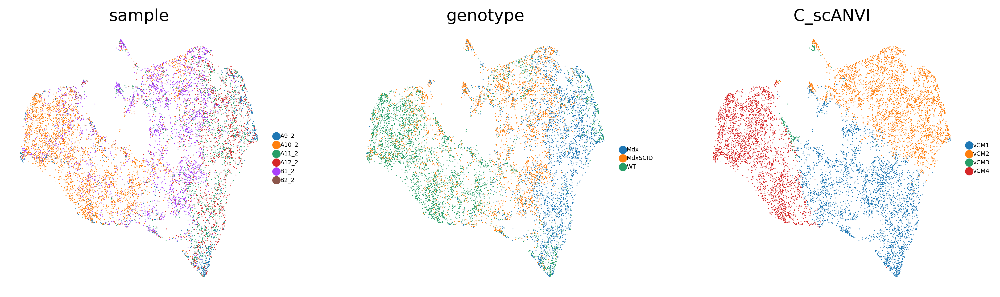

In [5]:
sc.pl.umap(adata, frameon = False, color = ['sample', 'genotype', 'C_scANVI'], size = 2.5, legend_fontsize = 5, ncols = 3)

### Tranform data to scan for transcriptional signatures

In [6]:
adata_log = adata.copy()
sc.pp.normalize_total(adata_log, target_sum = 1e6, exclude_highly_expressed = True)
sc.pp.log1p(adata_log)

normalizing counts per cell The following highly-expressed genes are not considered during normalization factor computation:
[]
    finished (0:00:00)


- Scan for Ferroptosis

In [18]:
ferroptosis_genes = ['Gpx4', 'Slc7a11', 'Slc40a1', 'Ftl1', 'Fth1', 'Acsl4', 'Alox5', 'Ptgs2', 'Nfe2l2', 'Hmox1', 'Sat1']
sc.tl.score_genes(adata_log,
                  gene_list = ferroptosis_genes,
                  score_name = 'ferroptosis_score',
                  random_state = 1712)

computing score 'ferroptosis_score'
    finished: added
    'ferroptosis_score', score of gene set (adata.obs).
    399 total control genes are used. (0:00:00)


/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:12

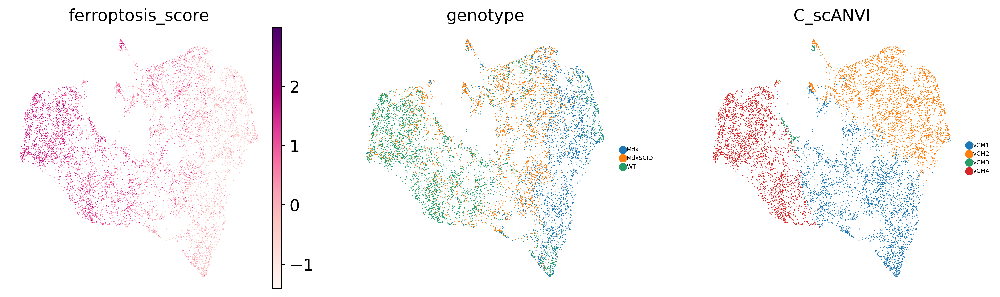

In [19]:
sc.pl.umap(adata_log, 
           frameon = False, 
           color = ['ferroptosis_score', 'genotype', 'C_scANVI'], 
           size = 2.5, 
           legend_fontsize = 5, 
           ncols = 3,
           cmap = 'RdPu')

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, 

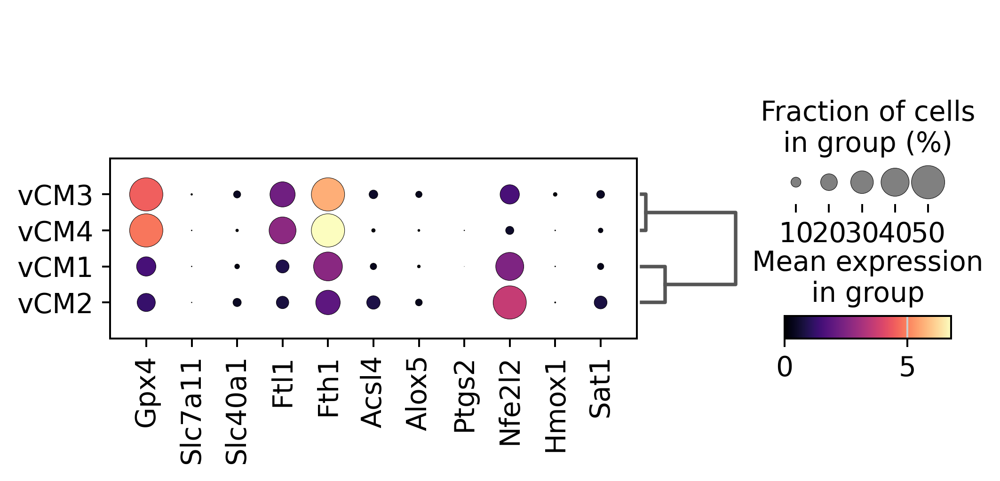

In [20]:
sc.pl.dotplot(adata_log, 
              ferroptosis_genes, 
              groupby = 'C_scANVI', 
              dot_max = 0.5, 
              dendrogram = True,
              cmap = 'magma')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_genotype']`


/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, Categ

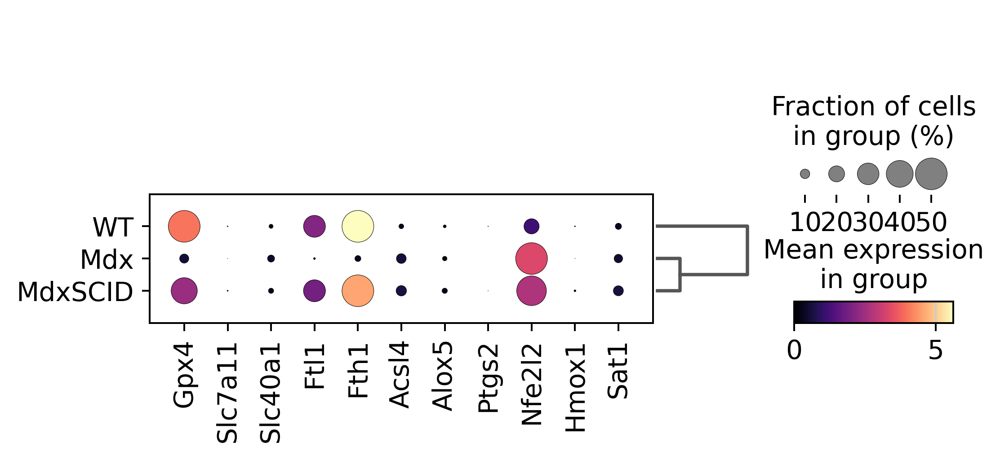

In [21]:
sc.pl.dotplot(adata_log, 
              ferroptosis_genes, 
              groupby = 'genotype', 
              dot_max = 0.5, 
              dendrogram = True,
              cmap = 'magma')

Scan for B2M activity via MHC-I pathway

In [14]:
mhci_genes = ['B2m', 'Tap1', 'Tap2', 'Tapbp', 'Pdia3', 'Calr', 'Psmb9', 'Psmb8']
sc.tl.score_genes(adata_log,
                  gene_list = mhci_genes,
                  score_name = 'MHC-I_score',
                  random_state = 1712)

computing score 'MHC-I_score'
    finished: added
    'MHC-I_score', score of gene set (adata.obs).
    300 total control genes are used. (0:00:00)


/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:12

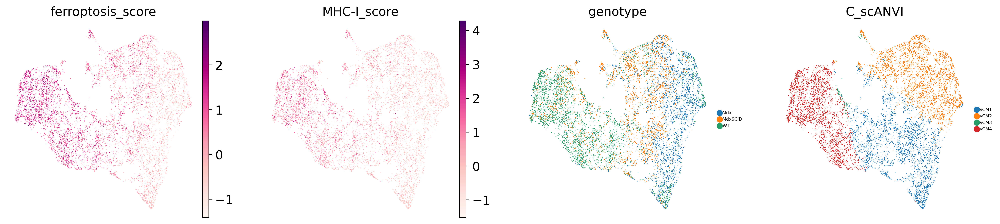

In [15]:
sc.pl.umap(adata_log, 
           frameon = False, 
           color = ['ferroptosis_score', 'MHC-I_score', 'genotype', 'C_scANVI'], 
           size = 2.5, 
           legend_fontsize = 5, 
           ncols = 4,
           cmap = 'RdPu')

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, 

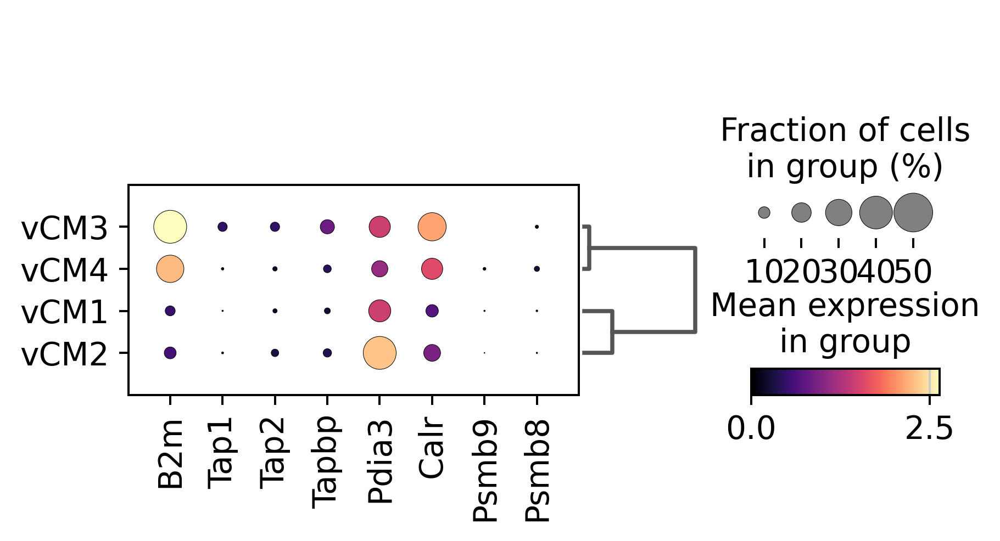

In [17]:
sc.pl.dotplot(adata_log, 
              mhci_genes, 
              groupby = 'C_scANVI', 
              dot_max = 0.5, 
              dendrogram = True,
              cmap = 'magma')

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, 

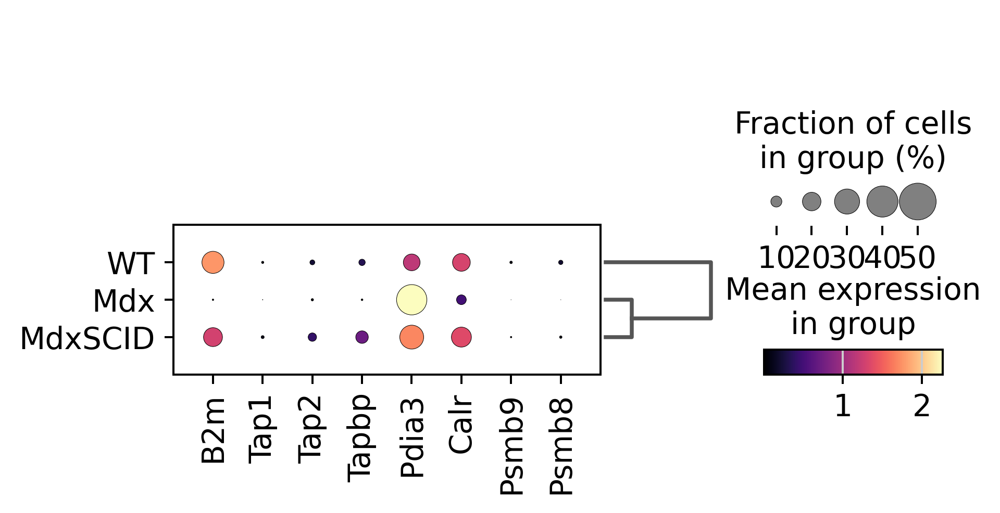

In [22]:
sc.pl.dotplot(adata_log, 
              mhci_genes, 
              groupby = 'genotype', 
              dot_max = 0.5, 
              dendrogram = True,
              cmap = 'magma')

- Scan for IL6 activity

In [23]:
il6_pathway_genes = ['Il6', 'Il6ra', 'Il6st', 'Socs3', 'Stat3', 'Jak1', 'Jak2', 'Bcl3', 'Cish']
sc.tl.score_genes(adata_log,
                  gene_list = il6_pathway_genes,
                  score_name = 'IL6_score',
                  random_state = 1712)

computing score 'IL6_score'
    finished: added
    'IL6_score', score of gene set (adata.obs).
    300 total control genes are used. (0:00:00)


/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:12

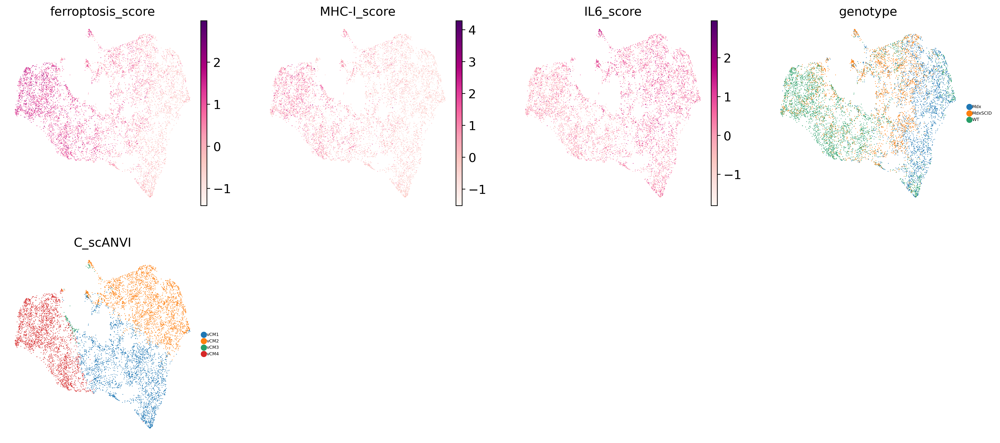

In [24]:
sc.pl.umap(adata_log, 
           frameon = False, 
           color = ['ferroptosis_score', 'MHC-I_score', 'IL6_score', 'genotype', 'C_scANVI'], 
           size = 2.5, 
           legend_fontsize = 5, 
           ncols = 4,
           cmap = 'RdPu')

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, 

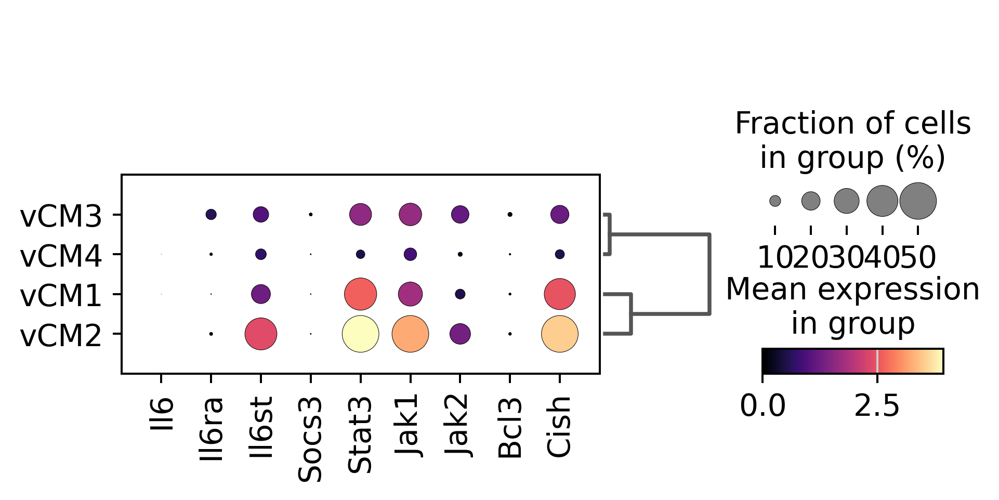

In [25]:
sc.pl.dotplot(adata_log, 
              il6_pathway_genes, 
              groupby = 'C_scANVI', 
              dot_max = 0.5, 
              dendrogram = True,
              cmap = 'magma')

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, 

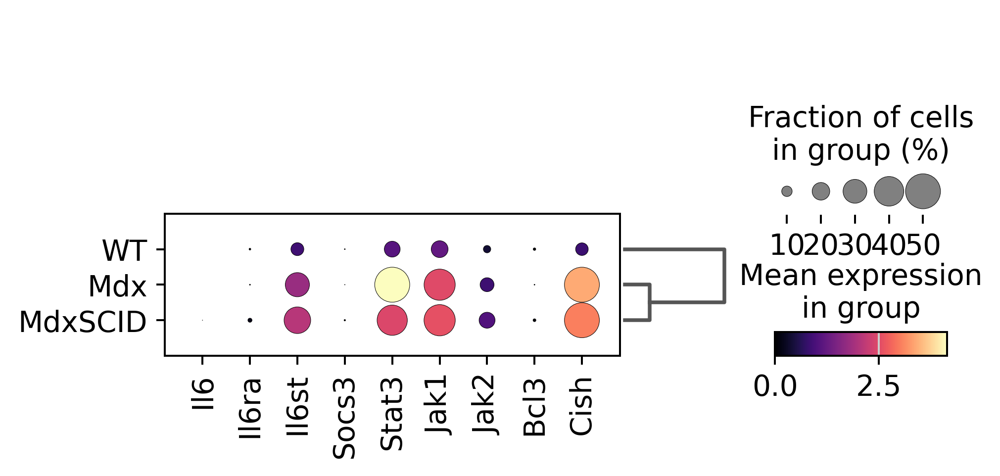

In [26]:
sc.pl.dotplot(adata_log, 
              il6_pathway_genes, 
              groupby = 'genotype', 
              dot_max = 0.5, 
              dendrogram = True,
              cmap = 'magma')

- Scan for IL10 activity

In [27]:
il10_pathway_genes = ['Il10', 'Il10ra', 'Il10rb', 'Jak1', 'Tyk2', 'Stat3', 'Socs3', 'Bcl3']
sc.tl.score_genes(adata_log,
                  gene_list = il10_pathway_genes,
                  score_name = 'IL10_score',
                  random_state = 1712)

computing score 'IL10_score'
    finished: added
    'IL10_score', score of gene set (adata.obs).
    400 total control genes are used. (0:00:00)


/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:12

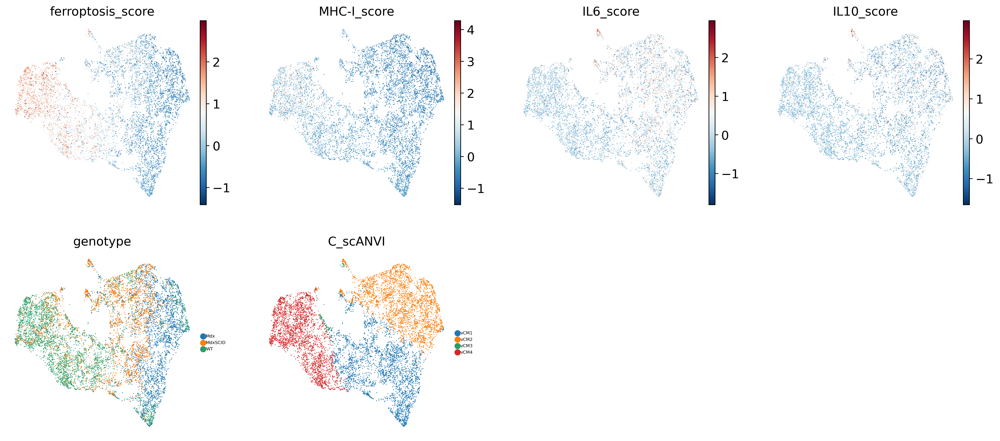

In [43]:
sc.pl.umap(adata_log, 
           frameon = False, 
           color = ['ferroptosis_score', 'MHC-I_score', 'IL6_score', 'IL10_score', 'genotype', 'C_scANVI'], 
           size = 4, 
           legend_fontsize = 5, 
           ncols = 4,
           cmap = 'RdBu_r')

/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:12

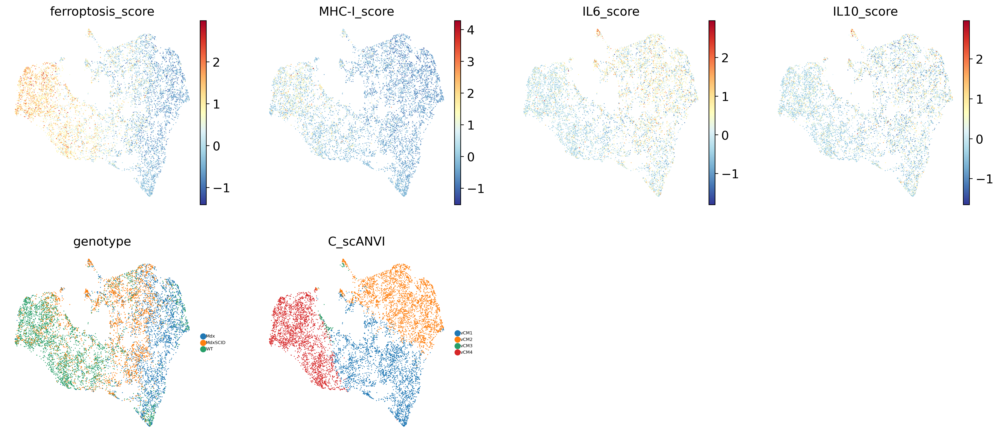

In [44]:
sc.pl.umap(adata_log, 
           frameon = False, 
           color = ['ferroptosis_score', 'MHC-I_score', 'IL6_score', 'IL10_score', 'genotype', 'C_scANVI'], 
           size = 4, 
           legend_fontsize = 5, 
           ncols = 4,
           cmap = 'RdYlBu_r')

- Combined ferroptosis score

In [46]:
ferroptosis_plus_genes = [
    'Aco2', 'Acsl4', 'Alox12', 'Alox15', 'Alox5', 'Atg4b', 'Atg5', 'Atg7', 
    'Cdkn1a', 'Cs', 'Cybb', 'Dlst', 'Fh1', 'Fth1', 'Ftl1', 
    'Gclc', 'Gclm', 'Gls2', 'Gpx4', 'Hmox1', 'Hspa1a', 'Hspa1b', 'Hspb1', 
    'Idh2', 'Lpcat3', 'Map1lc3a', 'Map1lc3b', 'Mdm2', 'Nfe2l2', 'Nox1', 'Nox4', 
    'Prdx1', 'Ptgs2', 'Sat1', 'Sdhb', 'Slc3a2', 'Slc40a1', 'Slc7a11', 
    'Sod1', 'Sod2', 'Sqstm1', 'Tfrc'
]
sc.tl.score_genes(adata_log,
                  gene_list = ferroptosis_plus_genes,
                  score_name = 'Ferroptosis+_score',
                  random_state = 1712)

computing score 'Ferroptosis+_score'
    finished: added
    'Ferroptosis+_score', score of gene set (adata.obs).
    700 total control genes are used. (0:00:00)


/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ruth/mambaforge/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:12

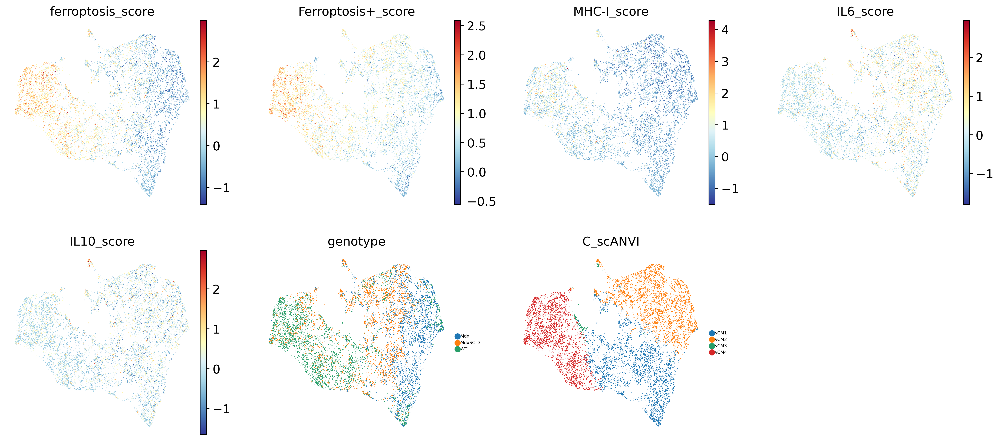

In [48]:
sc.pl.umap(adata_log, 
           frameon = False, 
           color = ['ferroptosis_score', 'Ferroptosis+_score', 'MHC-I_score', 'IL6_score', 'IL10_score', 'genotype', 'C_scANVI'], 
           size = 3, 
           legend_fontsize = 5, 
           ncols = 4,
           cmap = 'RdYlBu_r')